#### **IMPORTS**

In [40]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import matplotlib.pyplot as plt 
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from wordcloud import WordCloud, STOPWORDS

#### **THE MAIN DATA**

In [2]:
data = pd.read_csv('DATA/data.csv')
data.head()

,valence,year,acousticness,artists,danceability,duration_ms,energy,explicit,id,instrumentalness,key,liveness,loudness,mode,name,popularity,release_date,speechiness,tempo
0,0.0594,1921,0.982,"['Sergei Rachmaninoff', 'James Levine', 'Berli...",0.279,831667,0.211,0,4BJqT0PrAfrxzMOxytFOIz,0.878000,10,0.665,-20.096,1,"Piano Concerto No. 3 in D Minor, Op. 30: III. ...",4,1921,0.0366,80.954
1,0.9630,1921,0.732,['Dennis Day'],0.819,180533,0.341,0,7xPhfUan2yNtyFG0cUWkt8,0.000000,7,0.160,-12.441,1,Clancy Lowered the Boom,5,1921,0.4150,60.936
2,0.0394,1921,0.961,['KHP Kridhamardawa Karaton Ngayogyakarta Hadi...,0.328,500062,0.166,0,1o6I8BglA6ylDMrIELygv1,0.913000,3,0.101,-14.850,1,Gati Bali,5,1921,0.0339,110.339
3,0.1650,1921,0.967,['Frank Parker'],0.275,210000,0.309,0,3ftBPsC5vPBKxYSee08FDH,0.000028,5,0.381,-9.316,1,Danny Boy,3,1921,0.0354,100.109
4,0.2530,1921,0.957,['Phil Regan'],0.418,166693,0.193,0,4d6HGyGT8e121BsdKmw9v6,0.000002,3,0.229,-10.096,1,When Irish Eyes Are Smiling,2,1921,0.0380,101.665


In [3]:
data.shape

(170653, 19)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 170653 entries, 0 to 170652
Data columns (total 19 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   valence           170653 non-null  float64
 1   year              170653 non-null  int64  
 2   acousticness      170653 non-null  float64
 3   artists           170653 non-null  object 
 4   danceability      170653 non-null  float64
 5   duration_ms       170653 non-null  int64  
 6   energy            170653 non-null  float64
 7   explicit          170653 non-null  int64  
 8   id                170653 non-null  object 
 9   instrumentalness  170653 non-null  float64
 10  key               170653 non-null  int64  
 11  liveness          170653 non-null  float64
 12  loudness          170653 non-null  float64
 13  mode              170653 non-null  int64  
 14  name              170653 non-null  object 
 15  popularity        170653 non-null  int64  
 16  release_date      17

In [5]:
data.describe()

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo
count,170653.000000,170653.000000,170653.000000,170653.000000,1.706530e+05,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000,170653.000000
mean,0.528587,1976.787241,0.502115,0.537396,2.309483e+05,0.482389,0.084575,0.167010,5.199844,0.205839,-11.467990,0.706902,31.431794,0.098393,116.861590
std,0.263171,25.917853,0.376032,0.176138,1.261184e+05,0.267646,0.278249,0.313475,3.515094,0.174805,5.697943,0.455184,21.826615,0.162740,30.708533
min,0.000000,1921.000000,0.000000,0.000000,5.108000e+03,0.000000,0.000000,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000
25%,0.317000,1956.000000,0.102000,0.415000,1.698270e+05,0.255000,0.000000,0.000000,2.000000,0.098800,-14.615000,0.000000,11.000000,0.034900,93.421000
50%,0.540000,1977.000000,0.516000,0.548000,2.074670e+05,0.471000,0.000000,0.000216,5.000000,0.136000,-10.580000,1.000000,33.000000,0.045000,114.729000
75%,0.747000,1999.000000,0.893000,0.668000,2.624000e+05,0.703000,0.000000,0.102000,8.000000,0.261000,-7.183000,1.000000,48.000000,0.075600,135.537000
max,1.000000,2020.000000,0.996000,0.988000,5.403500e+06,1.000000,1.000000,1.000000,11.000000,1.000000,3.855000,1.000000,100.000000,0.970000,243.507000


In [6]:
data['loudness'][data['loudness'].between(0,3.855)] #Loudness should be between -60 and 0 

10365     0.878
29282     0.450
38418     0.457
40165     0.674
40413     3.855
42156     1.830
48539     0.265
55374     0.496
71842     0.522
72368     1.342
73026     0.161
74171     1.023
74672     0.175
82942     3.744
82953     1.275
93224     2.799
99291     1.006
105649    0.197
109515    0.474
124536    0.060
124554    0.101
131363    1.963
132085    0.143
132159    0.403
140902    0.523
152550    1.483
155209    0.418
155710    0.200
161894    0.289
161934    0.150
167375    1.073
Name: loudness, dtype: float64

#### **NOTE**
**We have to check if these values are correct , if not we will treat them as outliers and remove them**.

**The values of the other columns are all good (there is no problem so far)**

In [7]:
data['artists'].nunique() 

34088

#### **THE GENRE DATASET**

In [8]:
genre_data = pd.read_csv('DATA/data_by_genres.csv')
genre_data.head()

,mode,genres,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,21st century classical,0.979333,0.162883,1.602977e+05,0.071317,0.606834,0.361600,-31.514333,0.040567,75.336500,0.103783,27.833333,6
1,1,432hz,0.494780,0.299333,1.048887e+06,0.450678,0.477762,0.131000,-16.854000,0.076817,120.285667,0.221750,52.500000,5
2,1,8-bit,0.762000,0.712000,1.151770e+05,0.818000,0.876000,0.126000,-9.180000,0.047000,133.444000,0.975000,48.000000,7
3,1,[],0.651417,0.529093,2.328809e+05,0.419146,0.205309,0.218696,-12.288965,0.107872,112.857352,0.513604,20.859882,7
4,1,a cappella,0.676557,0.538961,1.906285e+05,0.316434,0.003003,0.172254,-12.479387,0.082851,112.110362,0.448249,45.820071,7


In [9]:
genre_data.shape

(2973, 14)

In [10]:
genre_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2973 entries, 0 to 2972
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              2973 non-null   int64  
 1   genres            2973 non-null   object 
 2   acousticness      2973 non-null   float64
 3   danceability      2973 non-null   float64
 4   duration_ms       2973 non-null   float64
 5   energy            2973 non-null   float64
 6   instrumentalness  2973 non-null   float64
 7   liveness          2973 non-null   float64
 8   loudness          2973 non-null   float64
 9   speechiness       2973 non-null   float64
 10  tempo             2973 non-null   float64
 11  valence           2973 non-null   float64
 12  popularity        2973 non-null   float64
 13  key               2973 non-null   int64  
dtypes: float64(11), int64(2), object(1)
memory usage: 325.3+ KB


In [11]:
genre_data.describe()

,mode,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,2973.000000,2973.000000,2973.000000,2.973000e+03,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000,2973.000000
mean,0.833165,0.401241,0.537187,2.517209e+05,0.561143,0.211366,0.192800,-10.509848,0.083588,119.018723,0.492748,39.919185,5.938782
std,0.372891,0.319760,0.150668,9.465686e+04,0.234486,0.267329,0.092356,5.369202,0.080483,17.469188,0.201820,16.748723,3.368110
min,0.000000,0.000003,0.056900,3.094600e+04,0.001002,0.000000,0.022200,-41.825000,0.023800,47.135722,0.003353,0.000000,0.000000
25%,1.000000,0.119050,0.441202,2.063788e+05,0.395058,0.004835,0.137687,-12.427656,0.044900,109.198143,0.348578,32.491279,3.000000
50%,1.000000,0.321745,0.546496,2.375453e+05,0.601195,0.080700,0.178764,-9.221817,0.059457,119.194167,0.500048,43.056569,7.000000
75%,1.000000,0.673991,0.647500,2.772720e+05,0.730127,0.343333,0.220856,-6.920125,0.091000,127.508750,0.640257,51.138889,9.000000
max,1.000000,0.996000,0.929000,2.382587e+06,0.994667,0.992000,0.960000,0.060000,0.946219,204.212000,0.980000,80.666667,11.000000


#### **NOTE**
**All values seem to be normal**

#### **THE YEAR DATASET**

In [12]:
year_data = pd.read_csv('DATA/data_by_year.csv')
year_data.head()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,1921,0.886896,0.418597,260537.166667,0.231815,0.344878,0.205710,-17.048667,0.073662,101.531493,0.379327,0.653333,2
1,1,1922,0.938592,0.482042,165469.746479,0.237815,0.434195,0.240720,-19.275282,0.116655,100.884521,0.535549,0.140845,10
2,1,1923,0.957247,0.577341,177942.362162,0.262406,0.371733,0.227462,-14.129211,0.093949,114.010730,0.625492,5.389189,0
3,1,1924,0.940200,0.549894,191046.707627,0.344347,0.581701,0.235219,-14.231343,0.092089,120.689572,0.663725,0.661017,10
4,1,1925,0.962607,0.573863,184986.924460,0.278594,0.418297,0.237668,-14.146414,0.111918,115.521921,0.621929,2.604317,5


In [13]:
year_data.shape

(100, 14)

In [14]:
year_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100 entries, 0 to 99
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              100 non-null    int64  
 1   year              100 non-null    int64  
 2   acousticness      100 non-null    float64
 3   danceability      100 non-null    float64
 4   duration_ms       100 non-null    float64
 5   energy            100 non-null    float64
 6   instrumentalness  100 non-null    float64
 7   liveness          100 non-null    float64
 8   loudness          100 non-null    float64
 9   speechiness       100 non-null    float64
 10  tempo             100 non-null    float64
 11  valence           100 non-null    float64
 12  popularity        100 non-null    float64
 13  key               100 non-null    int64  
dtypes: float64(11), int64(3)
memory usage: 11.1 KB


In [15]:
year_data.describe()

,mode,year,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,100.0,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.000000,100.0000
mean,1.0,1970.500000,0.556317,0.536783,227296.752234,0.452705,0.193582,0.208224,-11.969054,0.105861,116.015674,0.532120,27.376065,3.7900
std,0.0,29.011492,0.275358,0.052356,25630.048065,0.161738,0.122488,0.017903,3.105610,0.082128,5.669645,0.057809,20.703197,3.5627
min,1.0,1921.000000,0.219931,0.414445,156881.657475,0.207948,0.016376,0.168450,-19.275282,0.049098,100.884521,0.379327,0.140845,0.0000
25%,1.0,1945.750000,0.289516,0.500800,210889.193536,0.280733,0.103323,0.197509,-14.189232,0.064244,111.718626,0.497174,3.298200,0.0000
50%,1.0,1970.500000,0.459190,0.540976,235520.850833,0.495997,0.127644,0.206074,-11.773061,0.085763,117.455548,0.541503,33.619250,2.0000
75%,1.0,1995.250000,0.856711,0.570948,247702.738058,0.598008,0.276707,0.218493,-9.950542,0.104438,120.606644,0.570080,44.943375,7.0000
max,1.0,2020.000000,0.962607,0.692904,267677.823086,0.681778,0.581701,0.264335,-6.595067,0.490001,124.283129,0.663725,65.256542,10.0000


#### **THE ARTIST DATASET**

In [16]:
artist_data = pd.read_csv('DATA/data_by_artist.csv')
artist_data.head()

,mode,count,acousticness,artists,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
0,1,9,0.590111,"""Cats"" 1981 Original London Cast",0.467222,250318.555556,0.394003,0.011400,0.290833,-14.448000,0.210389,117.518111,0.389500,38.333333,5
1,1,26,0.862538,"""Cats"" 1983 Broadway Cast",0.441731,287280.000000,0.406808,0.081158,0.315215,-10.690000,0.176212,103.044154,0.268865,30.576923,5
2,1,7,0.856571,"""Fiddler On The Roof” Motion Picture Chorus",0.348286,328920.000000,0.286571,0.024593,0.325786,-15.230714,0.118514,77.375857,0.354857,34.857143,0
3,1,27,0.884926,"""Fiddler On The Roof” Motion Picture Orchestra",0.425074,262890.962963,0.245770,0.073587,0.275481,-15.639370,0.123200,88.667630,0.372030,34.851852,0
4,1,7,0.510714,"""Joseph And The Amazing Technicolor Dreamcoat""...",0.467143,270436.142857,0.488286,0.009400,0.195000,-10.236714,0.098543,122.835857,0.482286,43.000000,5


In [17]:
artist_data.shape

(28680, 15)

In [18]:
artist_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 28680 entries, 0 to 28679
Data columns (total 15 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   mode              28680 non-null  int64  
 1   count             28680 non-null  int64  
 2   acousticness      28680 non-null  float64
 3   artists           28680 non-null  object 
 4   danceability      28680 non-null  float64
 5   duration_ms       28680 non-null  float64
 6   energy            28680 non-null  float64
 7   instrumentalness  28680 non-null  float64
 8   liveness          28680 non-null  float64
 9   loudness          28680 non-null  float64
 10  speechiness       28680 non-null  float64
 11  tempo             28680 non-null  float64
 12  valence           28680 non-null  float64
 13  popularity        28680 non-null  float64
 14  key               28680 non-null  int64  
dtypes: float64(11), int64(3), object(1)
memory usage: 3.3+ MB


In [19]:
artist_data.describe()

,mode,count,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,popularity,key
count,28680.000000,28680.000000,28680.000000,28680.000000,2.868000e+04,28680.000000,28680.000000,28680.000000,28680.000000,28680.000000,28680.000000,28680.000000,28680.000000,28680.000000
mean,0.759170,13.847211,0.498373,0.546490,2.388780e+05,0.497488,0.174756,0.202441,-11.140498,0.094014,115.844830,0.512723,34.060945,5.412901
std,0.427595,53.372544,0.370614,0.176474,1.211318e+05,0.254885,0.298406,0.140884,5.771749,0.111986,25.003834,0.244421,22.376438,3.480552
min,0.000000,1.000000,0.000000,0.000000,1.879550e+04,0.000000,0.000000,0.000000,-60.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1.000000,2.000000,0.122296,0.431000,1.823304e+05,0.283568,0.000004,0.110362,-13.972292,0.039200,99.366500,0.329000,12.000000,2.000000
50%,1.000000,3.000000,0.478458,0.557000,2.186400e+05,0.504000,0.001880,0.161000,-10.088938,0.052200,115.357400,0.523243,39.000000,6.000000
75%,1.000000,8.000000,0.896000,0.675000,2.684670e+05,0.702783,0.215291,0.247000,-6.889000,0.095300,129.848750,0.703000,51.000000,8.000000
max,1.000000,3169.000000,0.996000,0.986000,5.403500e+06,1.000000,1.000000,0.991000,1.342000,0.964000,217.743000,0.991000,93.000000,11.000000


In [20]:
#Adding the decade column to 'data' dataset : 

data['decade'] = data['year'].apply(lambda x : (x // 10)*10)

In [21]:
data['decade']

0         1920
1         1920
2         1920
3         1920
4         1920
          ... 
170648    2020
170649    2020
170650    2020
170651    2020
170652    2020
Name: decade, Length: 170653, dtype: int64

#### **DATA EXPLORATION**

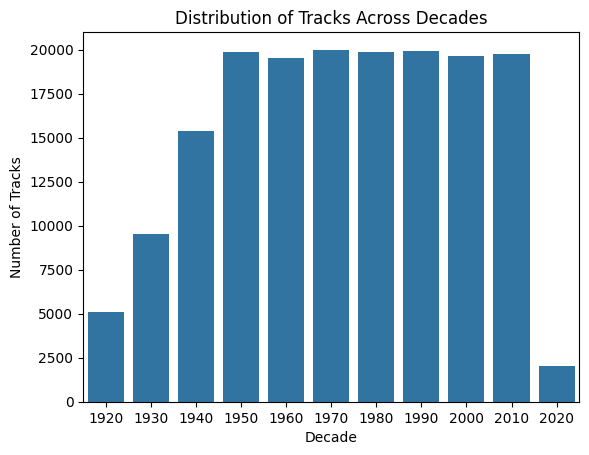

In [22]:
sns.countplot(x='decade', data=data)
plt.title('Distribution of Tracks Across Decades')
plt.xlabel('Decade')
plt.ylabel('Number of Tracks')
plt.show()

In [23]:
sound_features =['acousticness' , 'danceability' , 'energy' , 'instrumentalness' , 'liveness' , 'valence']
fig = px.line(year_data, x='year', y=sound_features, title='Trend of Various Sound Features Over Decades')
fig.show()

#### **DESCRIPTION OF THE GRAPH**

The graph depicts the trends of various sound features—acousticness, danceability, energy, instrumentalness, liveness, and valence—over the decades, starting from the early 20th century up to 2020. Each line represents one of these features, showing how its average value changes over time.

### **Key Observations:**
**Acousticness:**
This feature starts at a high level in the early decades, reflecting the dominance of acoustic recordings before electronic instruments and production became prevalent.
It shows a gradual decline from the 1930s to the 1970s, stabilizing at lower levels in more recent decades, likely due to the rise of electronic and digitally-produced music.

**Danceability:**
Danceability exhibits a more consistent trend with a slight increase in the modern era, indicating that recent music might be more rhythmically structured for dancing compared to older tracks.

**Energy:**
Energy increases steadily over the decades, peaking in the 1980s and 1990s, corresponding to the popularity of high-energy genres like rock and electronic dance music. It remains relatively high in the 2000s and beyond.

**Instrumentalness:**
Instrumentalness is high in the early years, reflecting the prevalence of instrumental music (e.g., classical or jazz) but decreases significantly after the 1930s as vocal-driven music becomes dominant.

**Liveness:**
Liveness fluctuates over time, with no clear upward or downward trend, but it remains relatively stable in modern decades. This could indicate that live-recorded elements have remained a constant feature in some tracks across eras.

**Valence:**
Valence (positiveness of music) appears to be on a slight decline in recent decades, which might suggest a shift toward more emotionally complex or melancholic tones in modern music.

### **Assumptions:**
The high acousticness and instrumentalness in earlier decades are likely due to the limited technology available for vocals and electronic music production at the time.
The rise in energy in the late 20th century coincides with cultural shifts toward faster-paced, high-energy genres like rock, hip-hop, and electronic dance music.
Danceability's increase in recent years could reflect the growing demand for music tailored for clubs, festivals, and social gatherings.
The slight decline in valence in the modern era might indicate a cultural preference for music that explores deeper or more diverse emotional themes.
This visualization offers valuable insights into how the characteristics of music have evolved, reflecting technological advancements, cultural trends, and shifting listener preferences.

In [24]:
loudness_fig = px.line(year_data, x='year', y='loudness', title='Trend of loudness over decades')
loudness_fig.show()

#### **Description of Loudness Trend Over Time:**

### **Early Decades (1900–1950):**
**Lower Loudness:** Tracks produced during the early 20th century typically had lower loudness levels due to the technological limitations of recording equipment. Analog recording methods had less dynamic range and lower amplification compared to modern systems.

**1950s–1980s:**
Gradual Increase: As recording technology advanced , music became louder. The rise of rock 'n' roll and other genres also emphasized louder tracks with amplified instruments.
Producers began mastering tracks with higher volume to grab listener attention, especially as the music industry expanded.

**1990s–2000s:**

**The "Loudness War":** This era saw a significant spike in loudness due to aggressive audio compression techniques. Producers prioritized higher average volume levels to make songs sound louder, especially in competitive genres like pop, hip-hop, and electronic dance music.
This led to reduced dynamic range, with tracks maintaining consistently high loudness throughout.

**2010s–2020s:**
Slight Decline in Loudness: In recent years, there has been a shift back to emphasizing dynamic range and better sound quality. This is partly due to criticism of the "Loudness War" and changes in streaming platforms like Spotify, which normalize playback loudness. As a result, tracks are still loud but less aggressively compressed compared to the 2000s.

In [25]:
top10_genres = genre_data.groupby(genre_data['genres']).mean(numeric_only=True) .sort_values('popularity', ascending=False).head(10).reset_index()

sound_features = ['valence', 'energy', 'danceability', 'acousticness']
top10_genres = top10_genres[['genres'] + sound_features]

bar_chart = px.bar(top10_genres, x='genres', y=['valence', 'energy', 'danceability', 'acousticness'], barmode='group', title='Trend of various sound features over top 10 genres')

bar_chart.update_layout(
    xaxis_title='Genres',
    yaxis_title='Sound Feature Values',
    legend_title='Sound Features',
    title_x=0.5
)

bar_chart.show()

#### **BAR-CHARTS DESCRIPTION**

This chart depicts the trends of four sound features—valence, energy, danceability, and acousticness—across the top 10 music genres ranked by popularity. The features are represented as grouped bars for each genre, allowing for a direct comparison of the attributes within and across genres.

### **Key Observations:**

**Valence (blue bars):**
Represents the positivity or happiness of a song.
Genres like Basshall and Afro Soul show moderately high valence, while others like Trap Venezolano and Russian Dance display lower values.

**Energy (red bars):**
Measures the intensity and activity level of songs.
High-energy genres include Basshall, South African House, and Guaracha, indicating these are more upbeat and dynamic genres.
Lower energy is observed in genres like Afro Soul and Chinese Electropop.

**Danceability (green bars):**
Reflects how suitable a track is for dancing.
Genres such as Guaracha, Basshall, and Afro Swing show high danceability, suggesting strong rhythmic patterns and tempo conducive to dancing.

**Acousticness (purple bars):**
Indicates the extent to which a song is acoustic.
Acousticness is notably low across most genres except for Alberta Hip Hop and Afro Soul, which exhibit slightly higher values, hinting at their reliance on traditional or natural instruments.

### **Genre-Specific Highlights:**

**Basshall:** Scores consistently high in energy, danceability, and valence, indicating a vibrant and uplifting genre.

**Guaracha:** Exhibits the highest energy and danceability, making it ideal for high-energy environments like dance floors.

**Afro Soul:** Balances higher acousticness with moderate valence and lower energy, aligning with its more relaxed, soulful style.

**Chinese Electropop:** Low in acousticness, energy, and valence, possibly representing a softer, more synthesized sound.

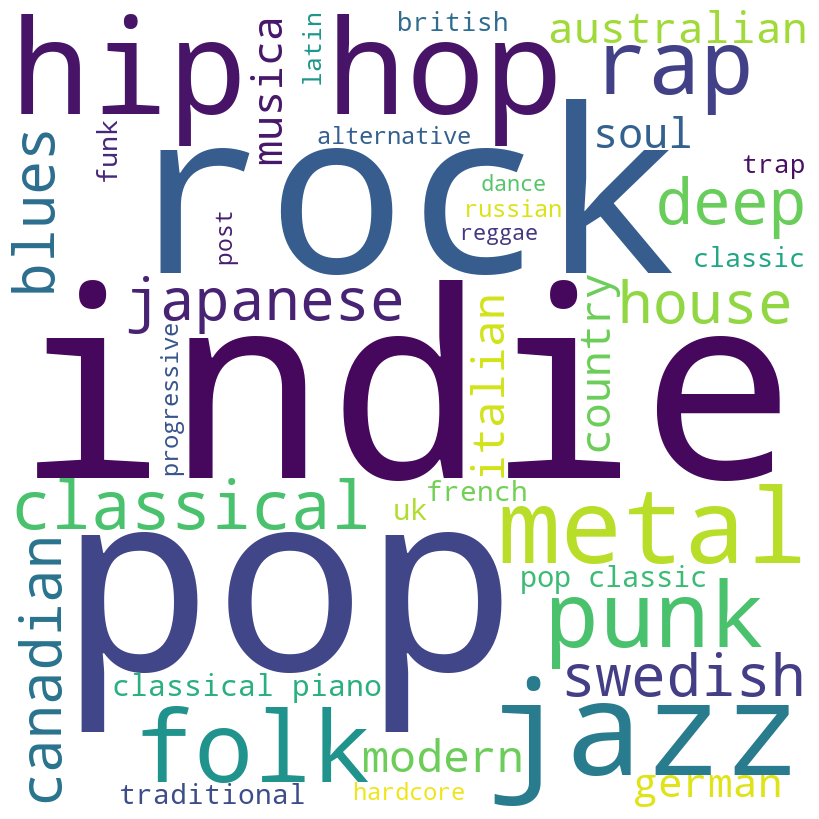

In [26]:
comment_words = ' '.join(genre_data['genres'])

stopwords = set(STOPWORDS)

wordcloud = WordCloud(width=800, height=800, 
                       background_color='white', 
                       stopwords=stopwords, 
                       max_words=40, 
                       min_font_size=10).generate(comment_words)

plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()

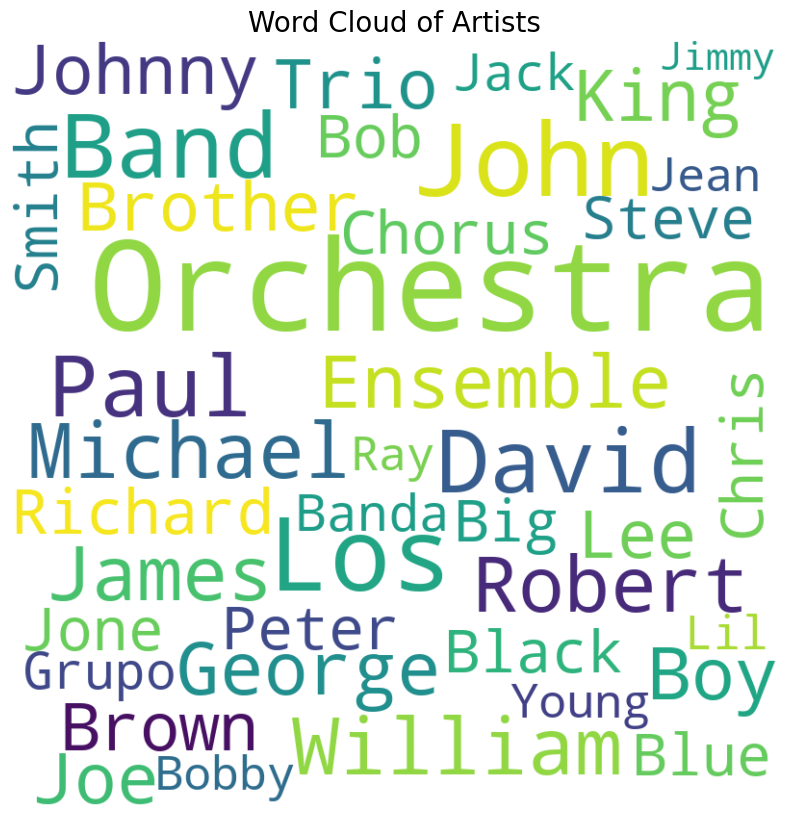

In [27]:
comment_words = ' '.join(artist for artist in artist_data['artists'])

stopwords = set(STOPWORDS)

wordcloud = WordCloud(width=800, height=800, 
                       background_color='white', 
                       stopwords=stopwords, 
                       min_word_length=3, 
                       max_words=40, 
                       min_font_size=10).generate(comment_words)

plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off") 
plt.title('Word Cloud of Artists', fontsize=20) 
plt.tight_layout(pad=0) 
plt.show()

In [28]:
top10_most_song_produced_artists = data.groupby('artists').size().reset_index(name='count')
top10_most_song_produced_artists = top10_most_song_produced_artists.sort_values('count', ascending=False).head(10)
top10_most_song_produced_artists[['count', 'artists']]


,count,artists
34009,1211,['Эрнест Хемингуэй']
34008,1068,['Эрих Мария Ремарк']
10023,942,['Francisco Canaro']
10107,630,['Frank Sinatra']
13408,628,['Ignacio Corsini']
8870,504,['Elvis Presley']
15621,484,['Johnny Cash']
4005,474,['Bob Dylan']
30299,471,['The Rolling Stones']
29182,455,['The Beach Boys']


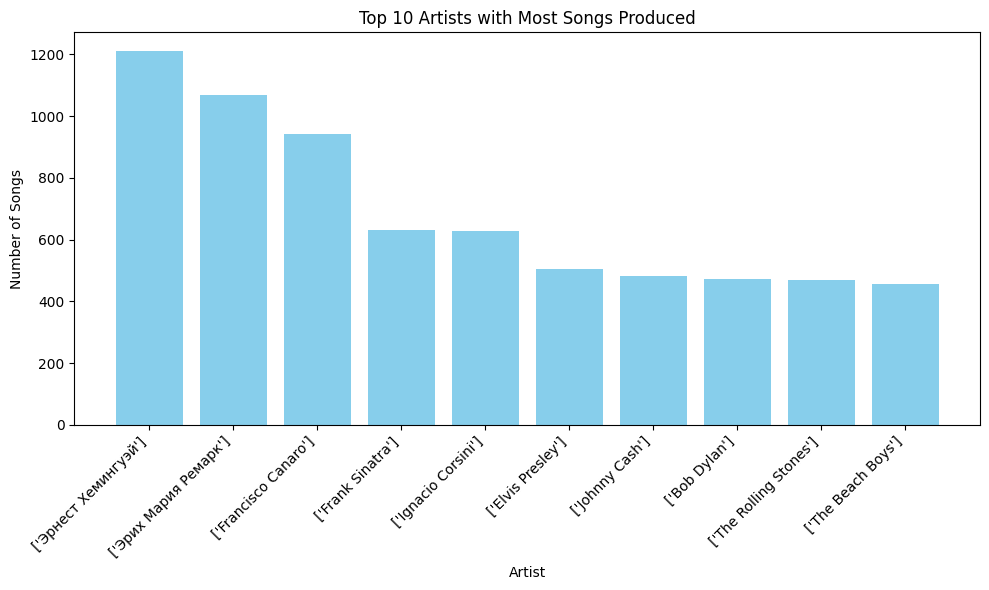

In [29]:
plt.figure(figsize=(10, 6))
plt.bar(top10_most_song_produced_artists['artists'], top10_most_song_produced_artists['count'], color='skyblue')

plt.xlabel('Artist')
plt.ylabel('Number of Songs')
plt.title('Top 10 Artists with Most Songs Produced')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.show()

In [30]:
top10_popular_artists = data[['artists', 'popularity']].sort_values('popularity', ascending=False).head(10)
top10_popular_artists[['popularity', 'artists']]


,popularity,artists
19611,100,"['Bad Bunny', 'Jhay Cortez']"
19606,99,"['24kGoldn', 'iann dior']"
19618,97,['BTS']
19608,96,"['Cardi B', 'Megan Thee Stallion']"
19610,96,['Ariana Grande']
19612,96,['Pop Smoke']
19616,96,['The Weeknd']
19607,95,"['Pop Smoke', 'Lil Baby', 'DaBaby']"
19615,95,"['Justin Bieber', 'Chance the Rapper']"
19620,95,"['Justin Bieber', 'benny blanco']"


#### **DESCRIPTION OF THE CHART**
**Song Counts:**

The bar chart representing the top 10 artists with the most songs produced (or appearances) shows the following artists with the highest counts:

**Эрнест Хемингуэй (Ernest Hemingway)** leads with 34,009 appearances.

**Эрих Мария Ремарк (Erich Maria Remarque)** follows closely with 34,008 appearances.

**Francisco Canaro** ranks third with 10,023 appearances.

**Frank Sinatra** comes in fourth with 10,107 appearances.

**Ignacio Corsini** appears 6,628 times in the dataset.

**Elvis Presley** has 8,870 appearances.

**Johnny Cash** appears 4,484 times.

**Bob Dylan** follows with 4,005 appearances.

**The Rolling Stones** have 3,299 appearances.

**The Beach Boys** complete the list with 2,182 appearances.

These artists are ranked by the frequency of their songs in the dataset, with Ernest Hemingway and Erich Maria Remarque being the top contributors. The higher song counts suggest that these artists might have had prolific music catalogs, as inferred from the numbers.



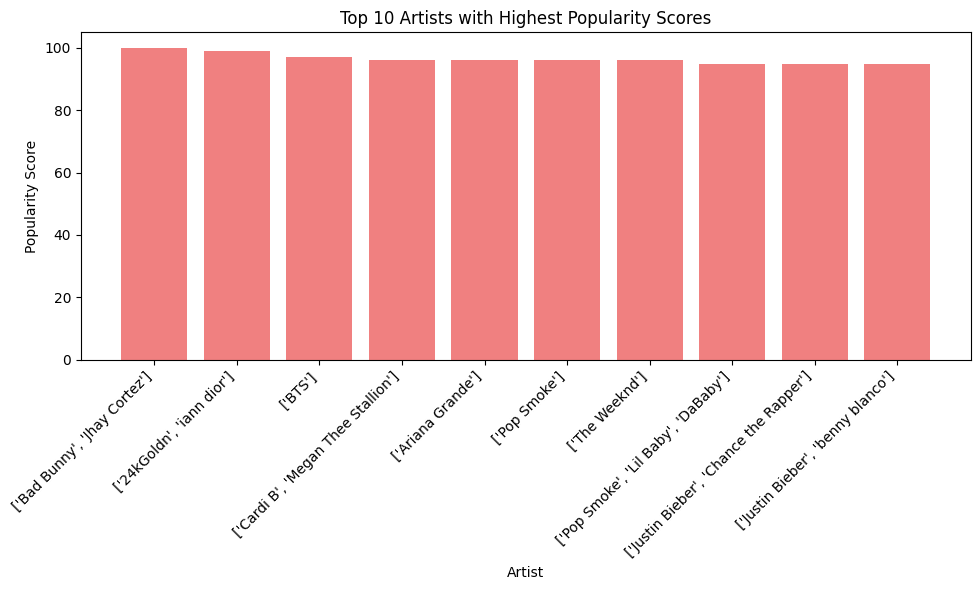

In [31]:
plt.figure(figsize=(10, 6))
plt.bar(top10_popular_artists['artists'], top10_popular_artists['popularity'], color='lightcoral')

plt.xlabel('Artist')
plt.ylabel('Popularity Score')
plt.title('Top 10 Artists with Highest Popularity Scores')
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

plt.show()

#### **DESCRIPTION OF THE RESULTS**

**Popularity Scores:**

The bar chart representing the top 10 artists with the highest popularity scores shows the following results:

**Bad Bunny & Jhay Cortez** have the highest popularity score of 100.

**24kGoldn & iann dior** follow with a popularity score of 99.

**BTS** has a score of 97, showing its global appeal.

**Cardi B & Megan Thee Stallion** both share a score of 96, as does Ariana Grande.

**Pop Smoke** also achieves a 96 popularity score, representing top-tier artists in the hip-hop and pop genres.

**The Weeknd** shares the same score of 96, indicating strong recognition in the music industry.

**Pop Smoke**, **Lil Baby**, and **DaBaby** each have a popularity score of 95.

**Justin Bieber & Chance the Rapper** also scored 95, showing their enduring popularity in mainstream music.

**Justin Bieber & benny blanco** complete the list with a popularity score of 95.

This chart highlights the significant popularity of contemporary artists, especially in the rap and pop genres, with Bad Bunny & Jhay Cortez leading the way with the highest score of 100. These high scores reflect how popular these artists are in the current music scene, making them influential figures in global music trends.

In [32]:
data.isnull().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
decade              0
dtype: int64

In [33]:
data.isna().sum()

valence             0
year                0
acousticness        0
artists             0
danceability        0
duration_ms         0
energy              0
explicit            0
id                  0
instrumentalness    0
key                 0
liveness            0
loudness            0
mode                0
name                0
popularity          0
release_date        0
speechiness         0
tempo               0
decade              0
dtype: int64

In [34]:
data.duplicated().sum()

np.int64(0)

In [36]:
numerical_data = data.select_dtypes(include=['number'])
numerical_data

,valence,year,acousticness,danceability,duration_ms,energy,explicit,instrumentalness,key,liveness,loudness,mode,popularity,speechiness,tempo,decade
0,0.0594,1921,0.98200,0.279,831667,0.211,0,0.878000,10,0.6650,-20.096,1,4,0.0366,80.954,1920
1,0.9630,1921,0.73200,0.819,180533,0.341,0,0.000000,7,0.1600,-12.441,1,5,0.4150,60.936,1920
2,0.0394,1921,0.96100,0.328,500062,0.166,0,0.913000,3,0.1010,-14.850,1,5,0.0339,110.339,1920
3,0.1650,1921,0.96700,0.275,210000,0.309,0,0.000028,5,0.3810,-9.316,1,3,0.0354,100.109,1920
4,0.2530,1921,0.95700,0.418,166693,0.193,0,0.000002,3,0.2290,-10.096,1,2,0.0380,101.665,1920
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
170648,0.6080,2020,0.08460,0.786,301714,0.808,0,0.000289,7,0.0822,-3.702,1,72,0.0881,105.029,2020
170649,0.7340,2020,0.20600,0.717,150654,0.753,0,0.000000,7,0.1010,-6.020,1,68,0.0605,137.936,2020
170650,0.6370,2020,0.10100,0.634,211280,0.858,0,0.000009,4,0.2580,-2.226,0,76,0.0809,91.688,2020
170651,0.1950,2020,0.00998,0.671,337147,0.623,1,0.000008,2,0.6430,-7.161,1,70,0.3080,75.055,2020


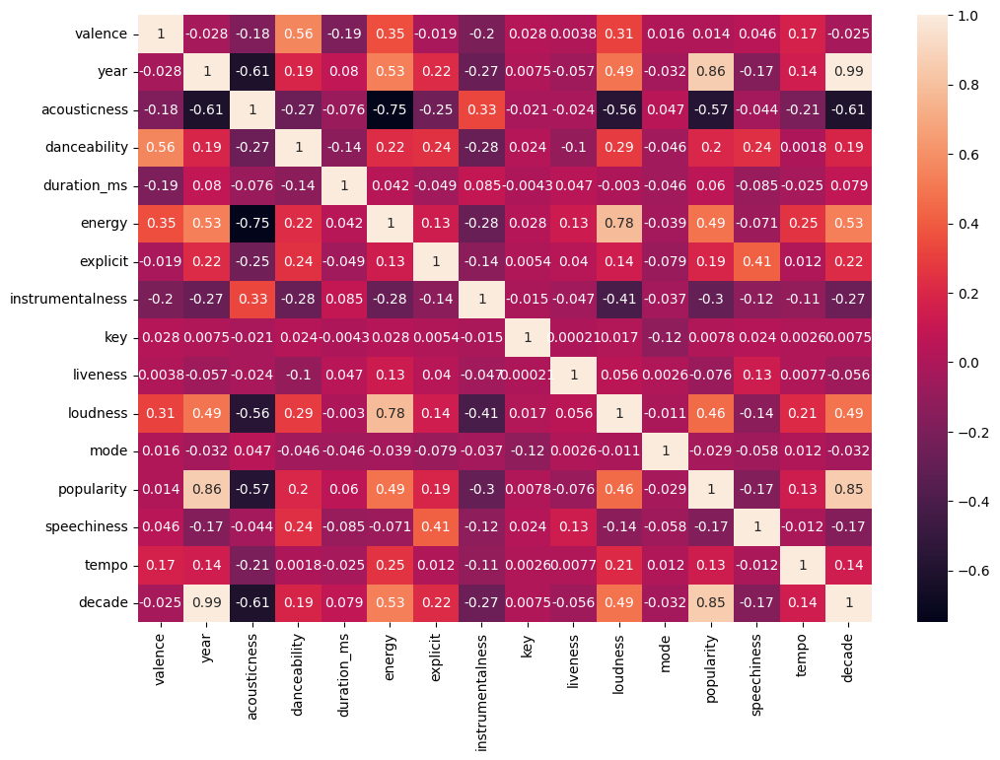

In [38]:
plt.figure(figsize=(12, 8))
sns.heatmap(numerical_data.corr() , annot=True)
plt.show()

#### **NOTE** 
The features year and decade are highly correlated , this may cause problems of multicolinearity so i think i'm not going to use the variable year for the model .   

#### **OUTLIERS**

In [42]:
def plots(df):
    figure = make_subplots(2,8)
    for i , column in enumerate(df.columns) :
        row = (i//8)+1
        col = (i%8)+1
        figure.add_trace(go.Box(y=df[column] , name= column) , row= row , col= col)
    figure.update_layout(width = 1000 , showlegend = False)
    figure.show()

plots(numerical_data)

#### **NOTE** 

OUTLIERS WON'T BE A PROBLEM IN OUR CASE :

Outliers could be niche or unique tracks that users might want to discover (songs with extreme speechiness or very high liveness).

**Outliers Reflect Real-World Diversity:**

In music datasets, what might seem like outliers could simply represent niche genres, rare styles, or special tracks 

**Collaborative Filtering:**

When using collaborative filtering (based on user preferences rather than content), outliers in song attributes may have less impact.